In [1]:
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
import cv2
from sklearn.feature_extraction.image import extract_patches_2d
from sklearn.feature_extraction.image import reconstruct_from_patches_2d
os.getcwd()

'/home/otto.tavares/public/segmentation_wnet'

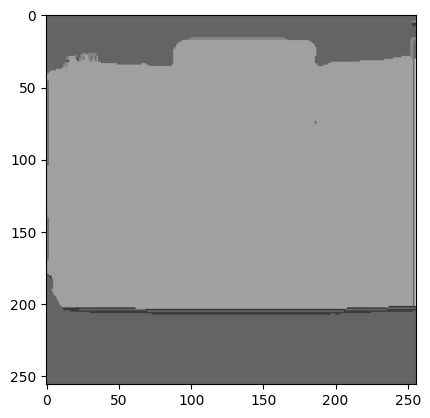

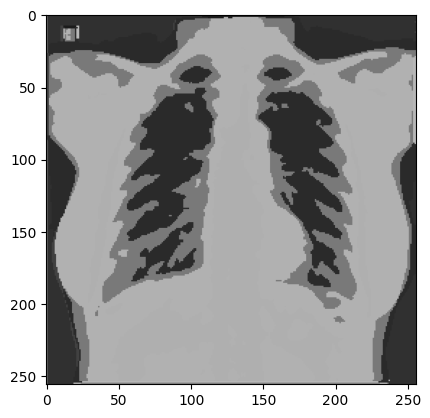

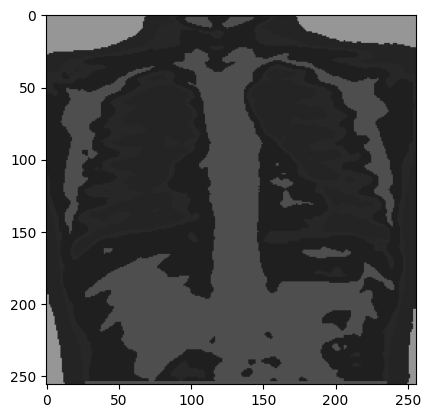

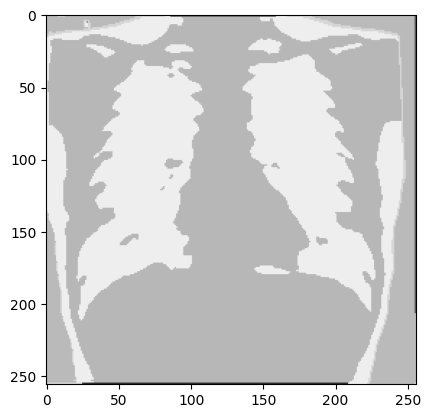

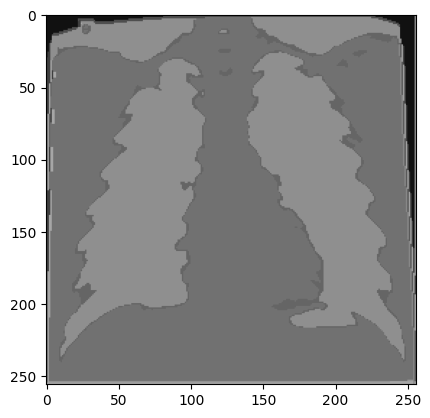

...

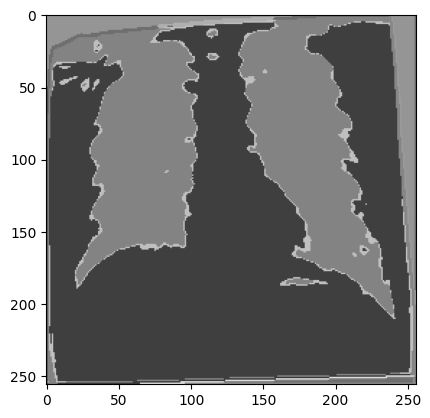

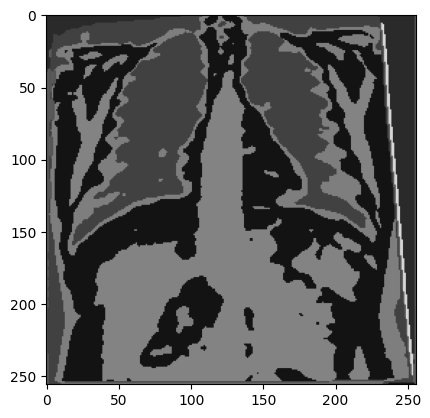

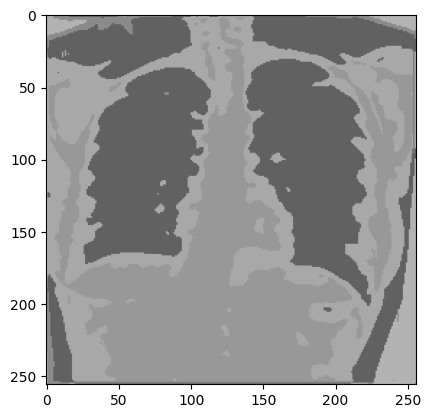

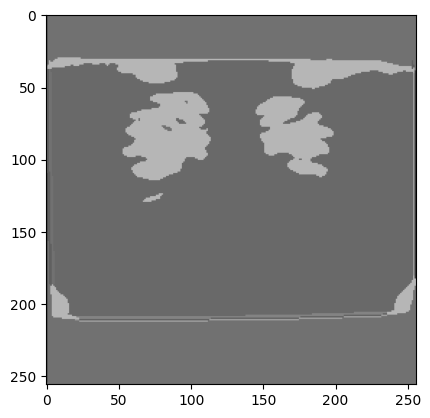

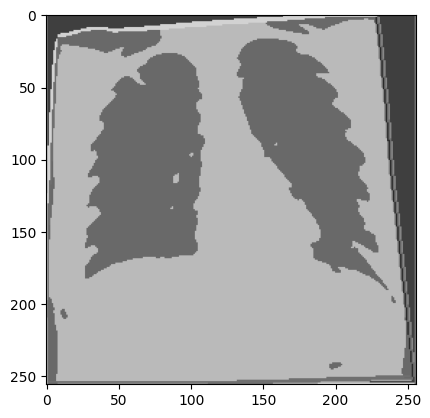

In [2]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/'
imgs = os.listdir(path)
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/%s' % (im_nm)
    im = Image.open(im_path).convert('L')
    plt.figure()
    plt.imshow(im, cmap='gray', vmin=0, vmax=255)
    plt.show()
    plt.close()

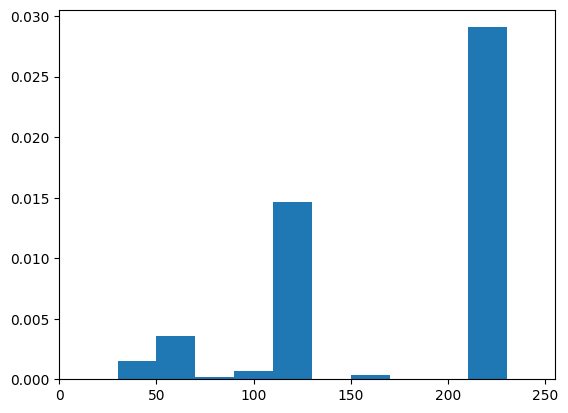

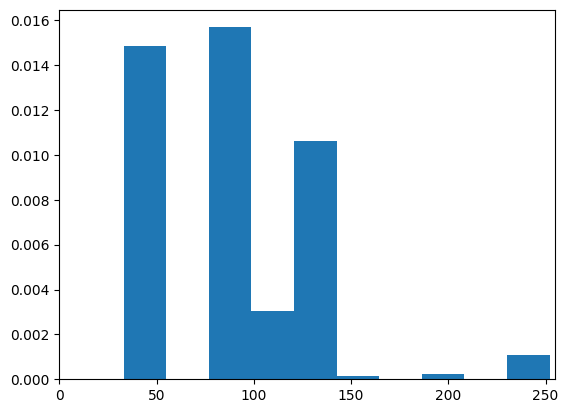

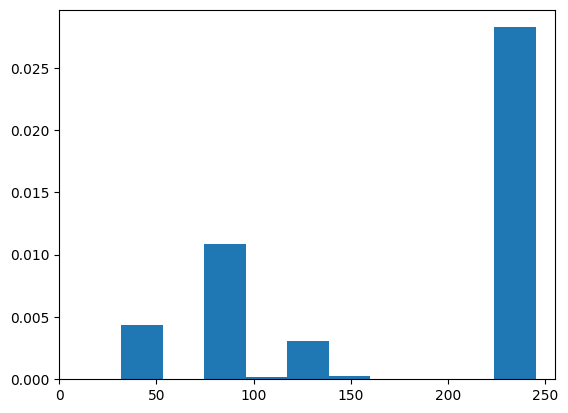

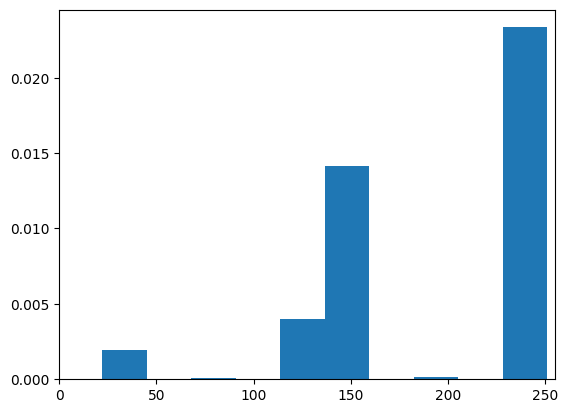

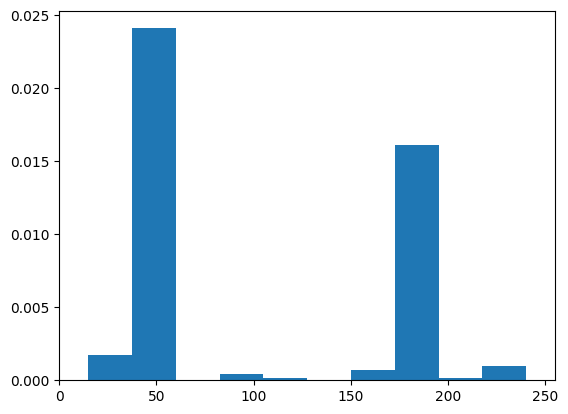

...

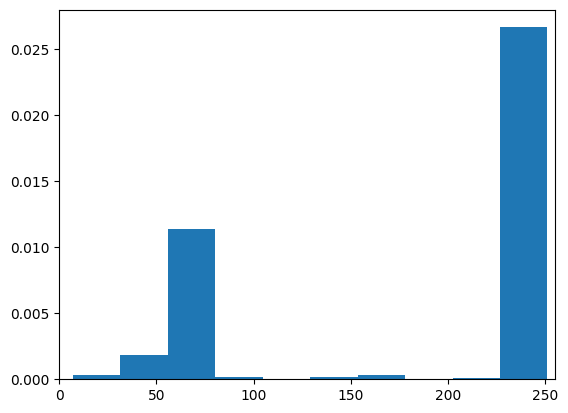

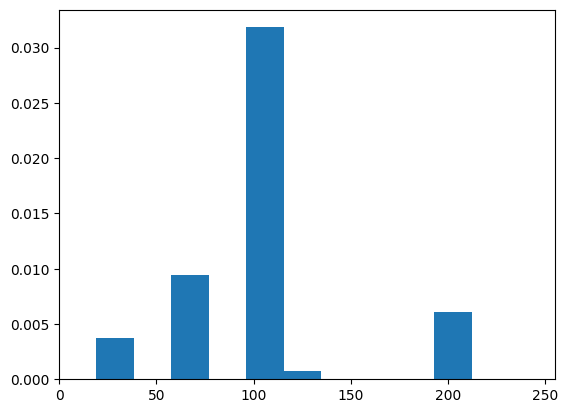

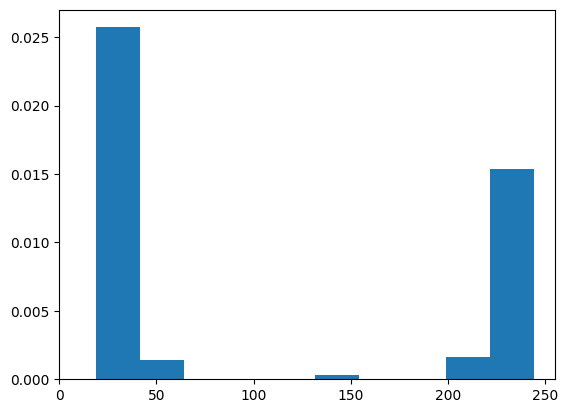

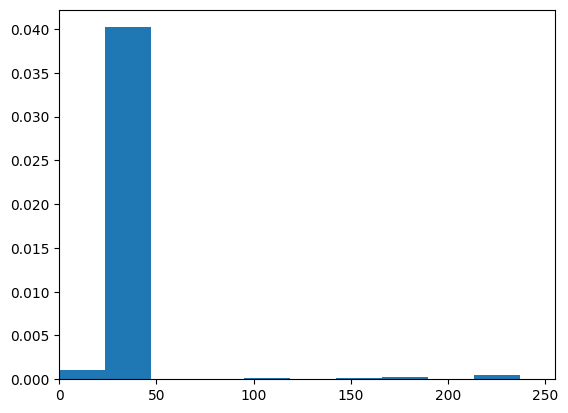

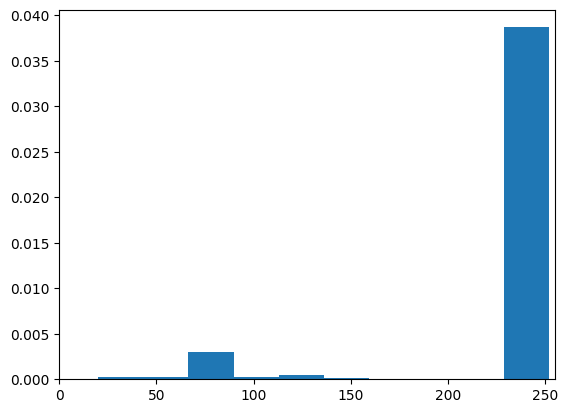

In [50]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid/'
imgs = os.listdir(path)
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid/%s' % (im_nm)
    im = np.asarray(Image.open(im_path))
    im = im[:,:,0]
    im = np.reshape(im,[im.shape[0]*im.shape[1]], order='C')
    histogram, bin_edges = np.histogram(im, bins = 256, range=(0, 1))
    plt.figure()
    plt.hist(im, density=True)
    plt.xlim( 0, 255 )
    plt.show()
    #plt.figure()
    #plt.title("Grayscale Histogram")
    #plt.xlabel("grayscale value")
    #plt.ylabel("pixel count")
    #plt.xlim([0.0, 1.0])  # <- named arguments do not work here
    #plt.plot(bin_edges[0:-1], histogram)
plt.close()

In [67]:
#TO-DO threshold binary by patch
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/%s' % (im_nm)
    # load the input image
    img = cv2.imread(im_path)
    
    # convert the input image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rect, tresh = cv2.threshold(gray,120,255,cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    patches = extract_patches_2d(gray, (32, 32), random_state = 512)
    tresh_patches = [cv2.threshold(ptch,120,255,cv2.THRESH_BINARY + cv2.THRESH_OTSU) for ptch in patches]
    print(tresh_patches[:, 0])
    seg_img = reconstruct_from_patches_2d(np.array(tresh_patches[:][1]), (256, 256))
    plt.subplot(131),plt.imshow(imgRGB,cmap = 'gray'),plt.title('Original Image'), plt.axis('off')
    plt.subplot(132),plt.imshow(gray,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(133),plt.imshow(seg_img,cmap = 'gray'),plt.title('Patches Image'),plt.axis('off')




TypeError: list indices must be integers or slices, not tuple

In [2]:
import pandas as pd
dic_masks = pd.read_excel('dicionario_masks.xlsx')[['image_name','binary_limiar', 'binary_limiar_aux']]

dic_masks_1 = dic_masks.loc[dic_masks['binary_limiar'] == 1]
dic_masks_0 = dic_masks.loc[dic_masks['binary_limiar'] == 0]



In [14]:
72+77

149

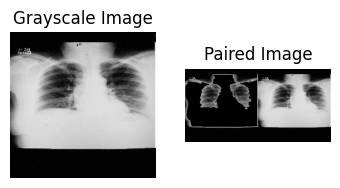

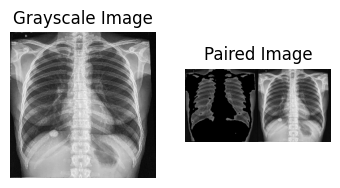

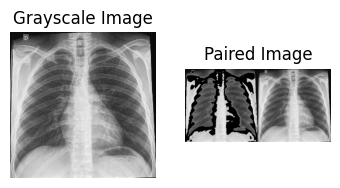

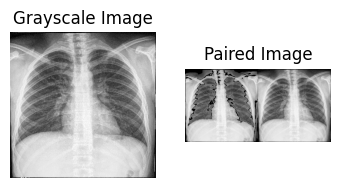

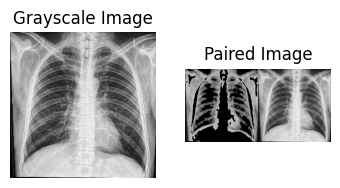

...

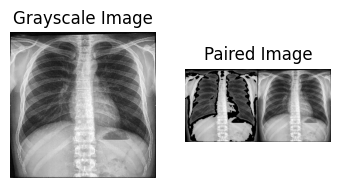

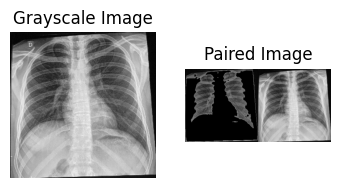

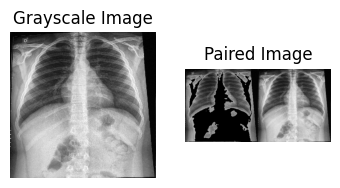

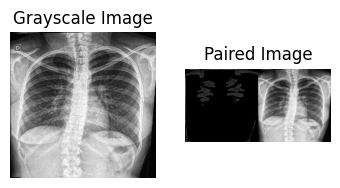

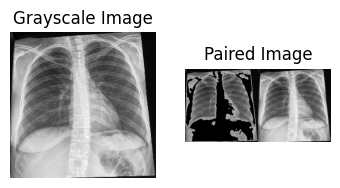

In [9]:
import pandas as pd
dic_masks = pd.read_excel('dicionario_masks.xlsx')[['image_name','binary_limiar', 'binary_limiar_aux']]

dic_masks_1 = dic_masks.loc[dic_masks['binary_limiar'] == 1]
dic_masks_0 = dic_masks.loc[dic_masks['binary_limiar'] == 0]


for nm in dic_masks_1['image_name']:
    path_img = '/home/brics/public/brics_data/SantaCasa/imageamento_anonimizado_valid/raw/images/%s' % (nm.replace('mask_', ''))
    path_mask = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/%s' % (nm)
    path_pair = '/home/otto.tavares/public/iltbi/train/images/imageamento_anonimizado_valid_AB/%s' % (nm.replace('mask_', ''))
    mask = cv2.cvtColor(cv2.imread(path_mask), cv2.COLOR_BGR2GRAY)
    
    ret,thresh_mask = cv2.threshold(mask,122,255,cv2.THRESH_BINARY_INV + 
                                            cv2.THRESH_OTSU)

    dim = (len(thresh_mask),len(thresh_mask))
    im = cv2.cvtColor(cv2.resize(cv2.imread(path_img), dim, interpolation=cv2.INTER_CUBIC),cv2.COLOR_BGR2GRAY)
    mask_par = (thresh_mask/255) * im
    im_pair = np.concatenate([mask_par, im], 1)
    plt.subplot(131),plt.imshow(im,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(im_pair,cmap = 'gray'),plt.title('Paired Image'),plt.axis('off')
    plt.show()
    cv2.imwrite(path_pair, im_pair)

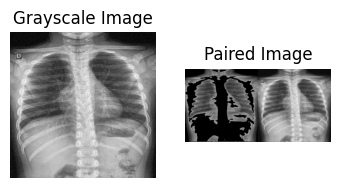

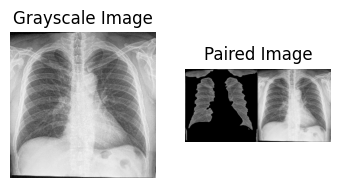

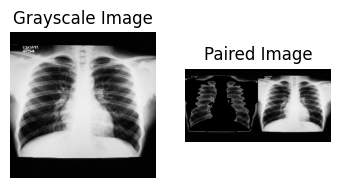

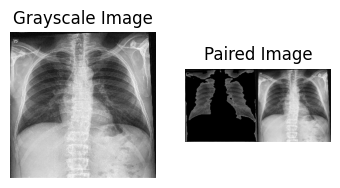

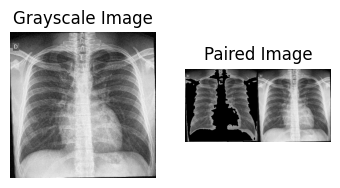

...

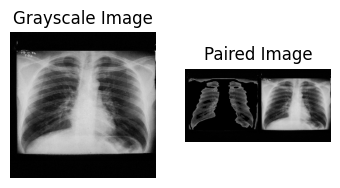

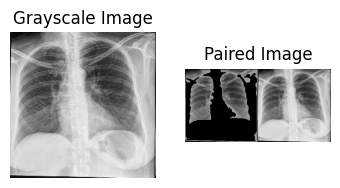

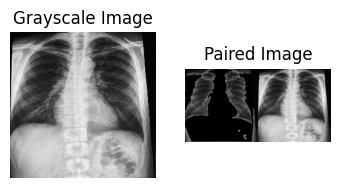

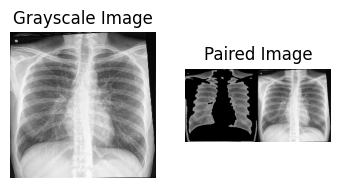

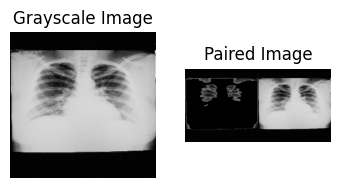

In [12]:
import pandas as pd
dic_masks = pd.read_excel('dicionario_masks.xlsx')[['image_name','binary_limiar', 'binary_limiar_aux']]

dic_masks_1 = dic_masks.loc[dic_masks['binary_limiar'] == 1]
dic_masks_0 = dic_masks.loc[dic_masks['binary_limiar'] == 0]


for nm in dic_masks_0['image_name']:
    path_img = '/home/brics/public/brics_data/SantaCasa/imageamento_anonimizado_valid/raw/images/%s' % (nm.replace('mask_', ''))
    path_mask = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/%s' % (nm)
    path_pair = '/home/otto.tavares/public/iltbi/train/images/imageamento_anonimizado_valid_AB/%s' % (nm.replace('mask_', ''))
    mask = cv2.cvtColor(cv2.imread(path_mask), cv2.COLOR_BGR2GRAY)
    
    ret,thresh_mask = cv2.threshold(mask,122,255,cv2.THRESH_BINARY + 
                                            cv2.THRESH_OTSU)
    dim = (len(thresh_mask),len(thresh_mask))
    im = cv2.cvtColor(cv2.resize(cv2.imread(path_img), dim, interpolation=cv2.INTER_CUBIC),cv2.COLOR_BGR2GRAY)
    mask_par = (thresh_mask/255) * im
    im_pair = np.concatenate([mask_par, im], 1)
    plt.subplot(131),plt.imshow(im,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(im_pair,cmap = 'gray'),plt.title('Paired Image'),plt.axis('off')
    plt.show()
    cv2.imwrite(path_pair, im_pair)

mask_editi_20220317_160519_692793.png


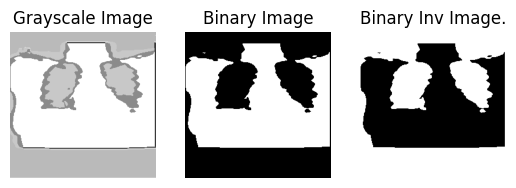

mask_editi_IMG_7090_heic_0D87FD.png


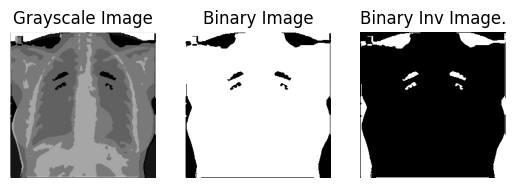

mask_editi_IMG_6298_4FE80C.png


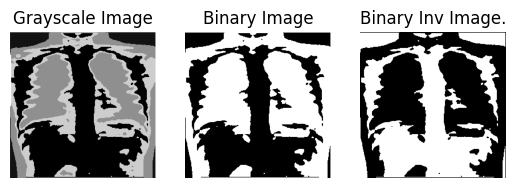

mask_editi_IMG_8097_D3E659.png


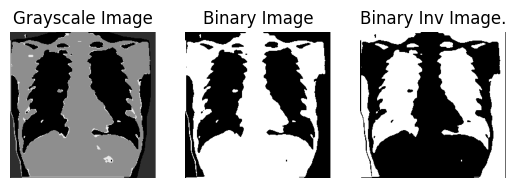

mask_editi_IMG_8086_4E9FBA.png


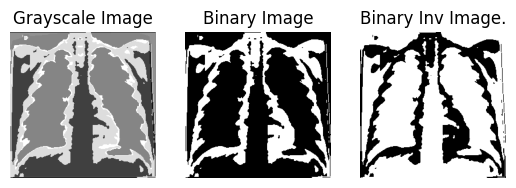

mask_editi_IMG_7073_F07950.png


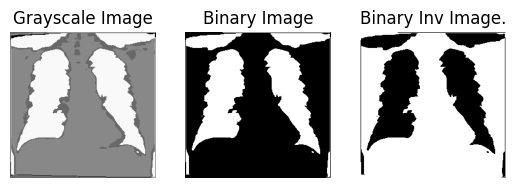

mask_editi_20220317_164823_584AC7.png


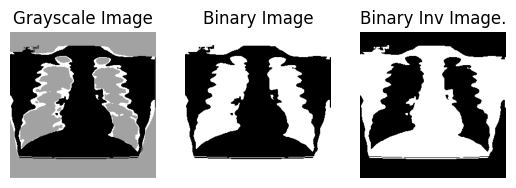

mask_editi_IMG_7772_F71BC4.png


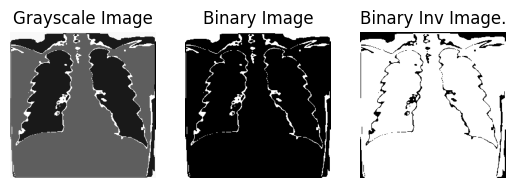

mask_editi_IMG_7967_1B0198.png


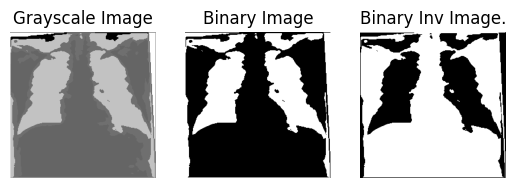

mask_editi_IMG_7539_3E183C.png


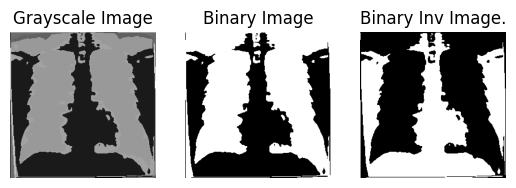

mask_editi_IMG_7126_heic_C3147E.png


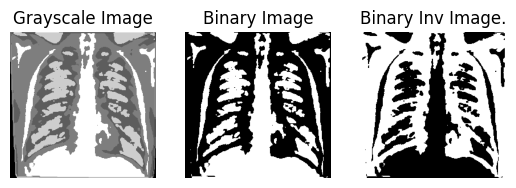

mask_editi_IMG_9010_E12289.png


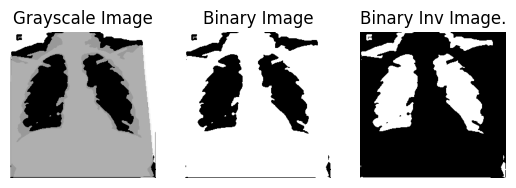

mask_editi_IMG_9310_306842.png


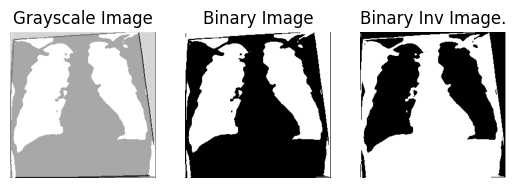

mask_editi_IMG_8849_D1750A.png


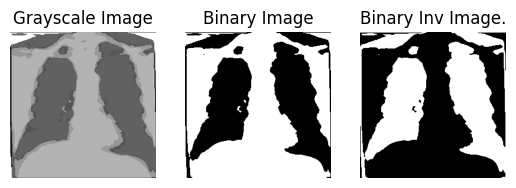

mask_editi_IMG_6227_2C3C82.png


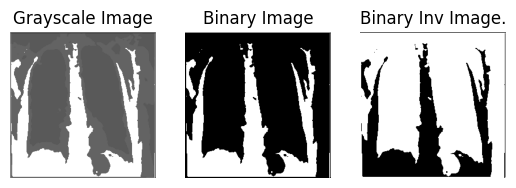

mask_editi_IMG_6881_6AFF3F.png


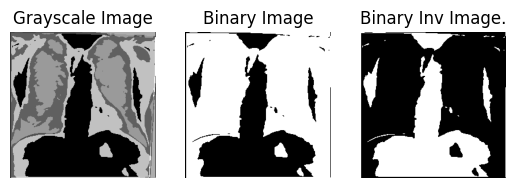

mask_editi_20220315_191225_4FF83C.png


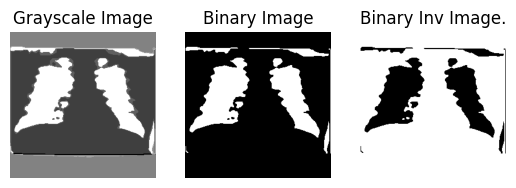

mask_editi_IMG_6369_E8B6A3.png


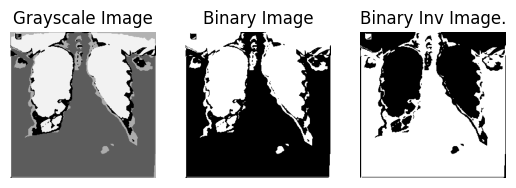

mask_editi_IMG_6844_heic_12D975.png


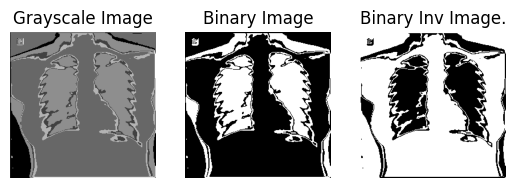

mask_editi_IMG_9568_CE0F9D.png


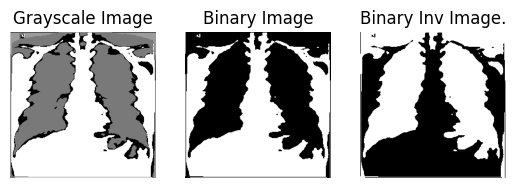

mask_editi_IMG_5503_F022CF.png


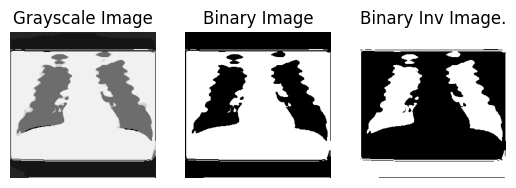

mask_editi_IMG_9613_24A791.png


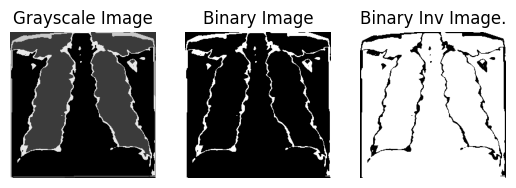

mask_editi_IMG_6913_8AB334.png


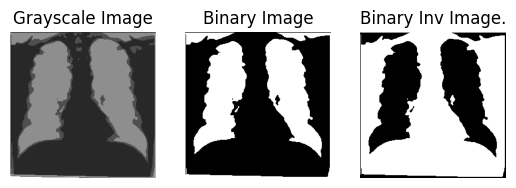

mask_editi_IMG_6122_heic_5559E3.png


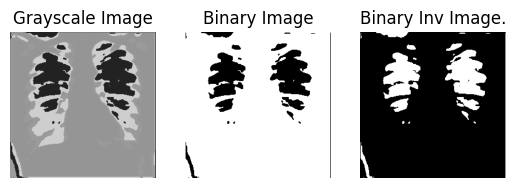

mask_editi_20220317_160048_5CC719.png


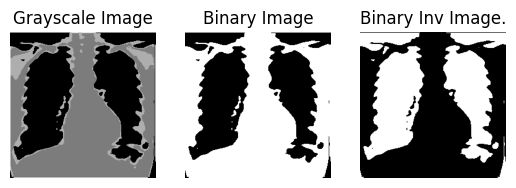

mask_editi_20220317_151153_7F82F7.png


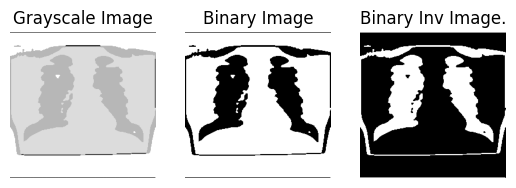

mask_editi_IMG_9483_A8414E.png


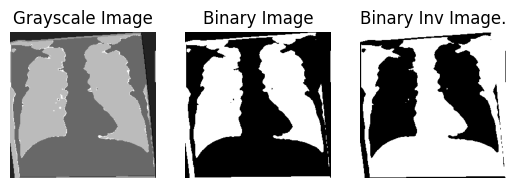

mask_editi_IMG_7147_heic_8D240B.png


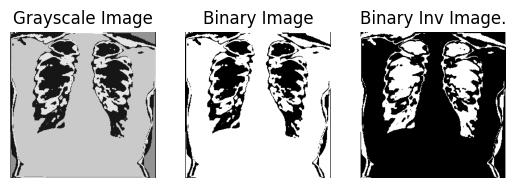

mask_editi_IMG_7489_F33F93.png


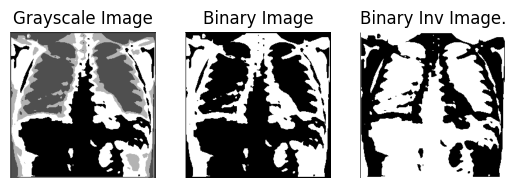

mask_editi_20220321_154200_E46274.png


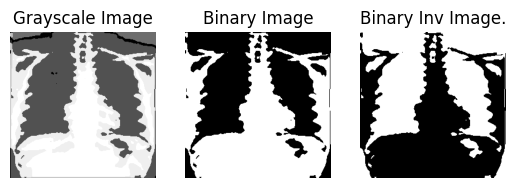

mask_editi_20220317_152422_D44659.png


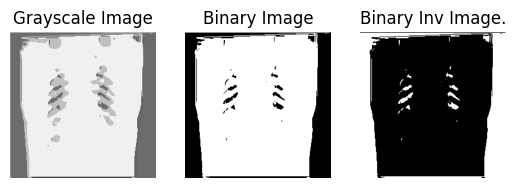

mask_editi_20220317_151737_84B30B.png


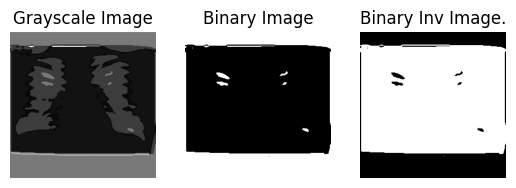

mask_editi_20220317_171020_77A819.png


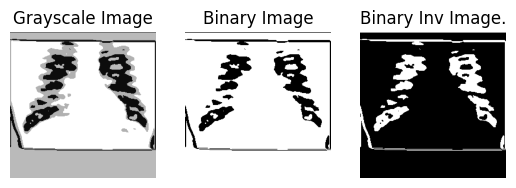

mask_editi_20220317_152019_C3C990.png


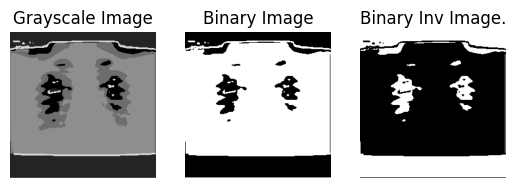

mask_editi_IMG_0233_2969CC.png


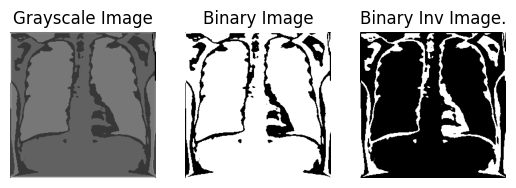

mask_editi_IMG_6805_85A524.png


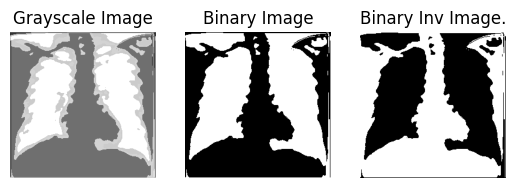

mask_editi_IMG_9379_8F54DF.png


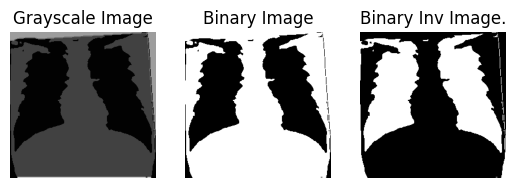

mask_editi_20220317_161545_DC0004.png


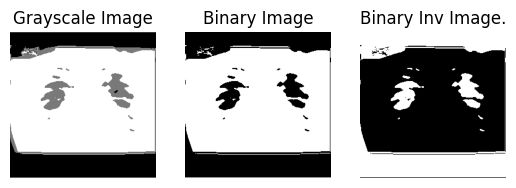

mask_editi_20220317_162921_A6C600.png


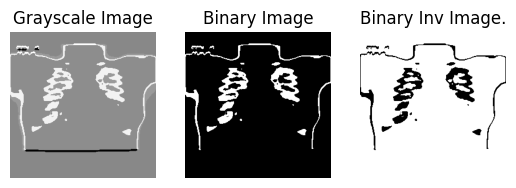

mask_editi_IMG_9528_D89FF5.png


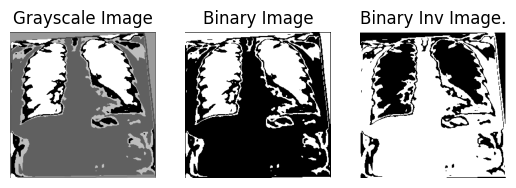

mask_editi_20220317_181158_4A3E76.png


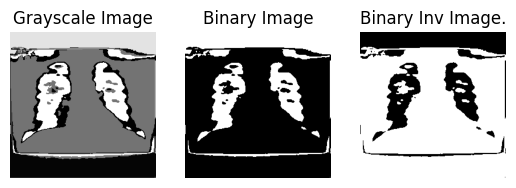

mask_editi_IMG_7128_heic_900A15.png


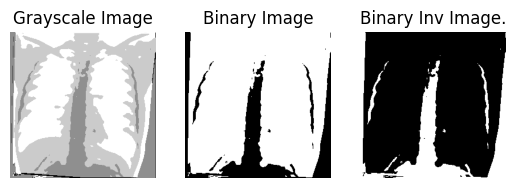

mask_editi_IMG_8466_E83237.png


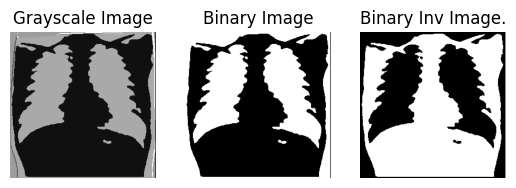

mask_editi_IMG_6280_FE3862.png


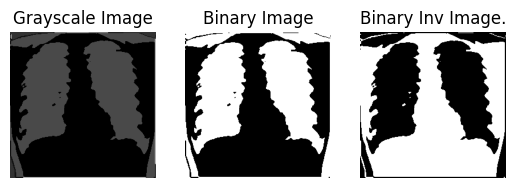

mask_editi_IMG_6712_2A04EE.png


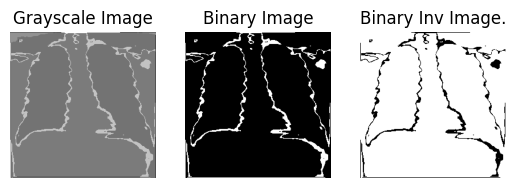

mask_editi_IMG_7795_29FE3A.png


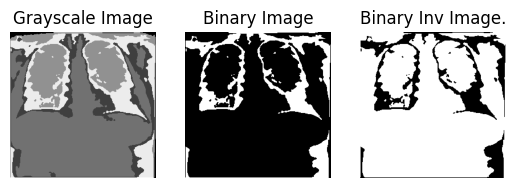

mask_editi_IMG_6689_1BDB5D.png


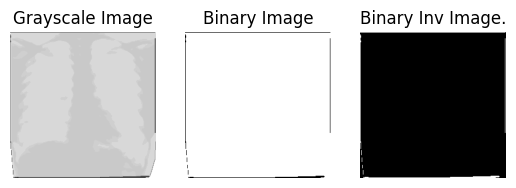

mask_editi_IMG_9109_079B33.png


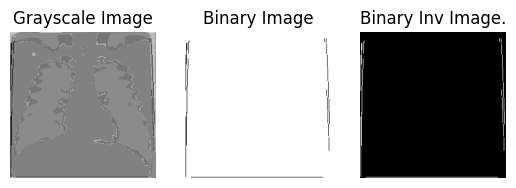

mask_editi_IMG_7924_67E9FB.png


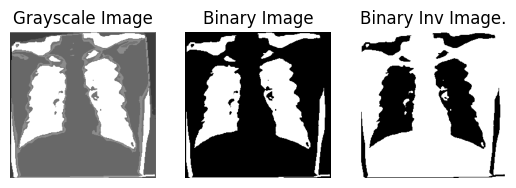

mask_editi_20220315_192525_264B09.png


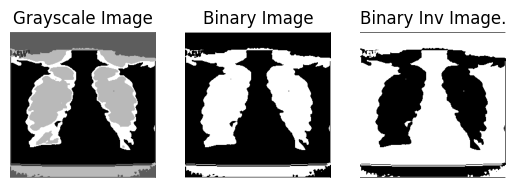

mask_editi_20220315_192116_C26327.png


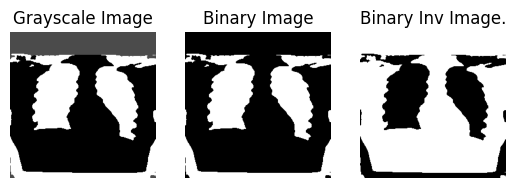

mask_editi_IMG_7181_heic_21AACC.png


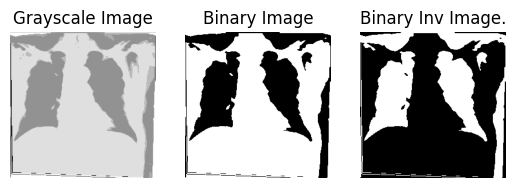

mask_editi_IMG_7624_A8203E.png


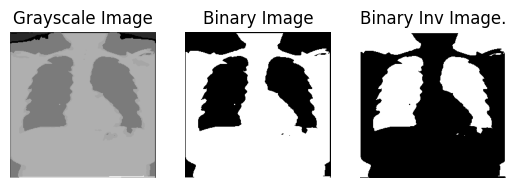

mask_editi_IMG_8018_7C6146.png


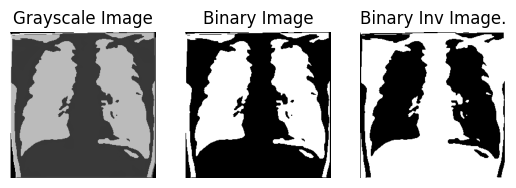

mask_editi_20220315_192652_93217A.png


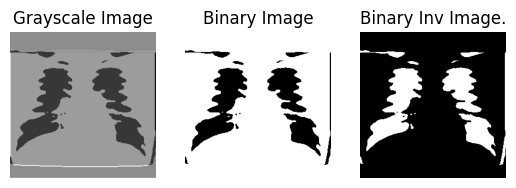

mask_editi_IMG_8269_BE68AF.png


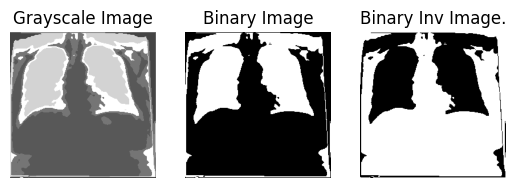

mask_editi_IMG_9298_29F1E2.png


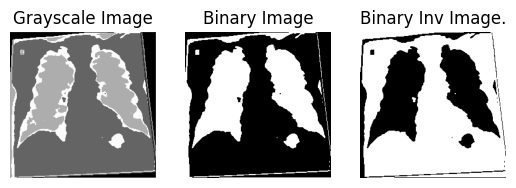

mask_editi_IMG_9268_682F0B.png


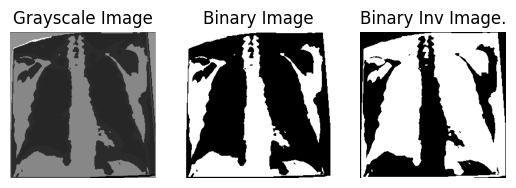

mask_editi_IMG_9148_181CF9.png


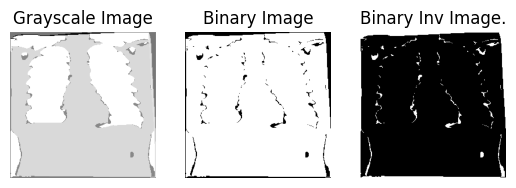

mask_editi_IMG_8431_BEB82B.png


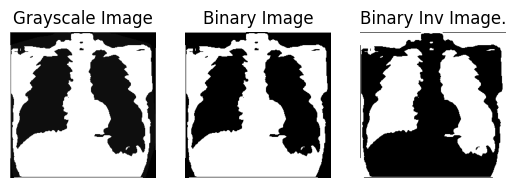

mask_editi_IMG_8498_A6E658.png


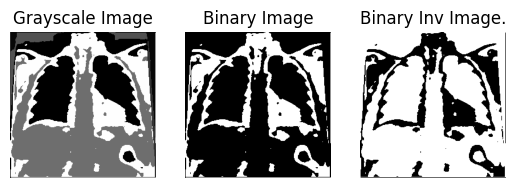

mask_editi_IMG_7905_D781E2.png


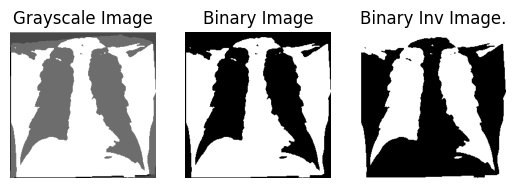

mask_editi_IMG_7033_6B5D39.png


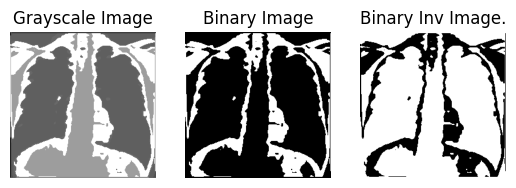

mask_editi_IMG_6180_CB342D.png


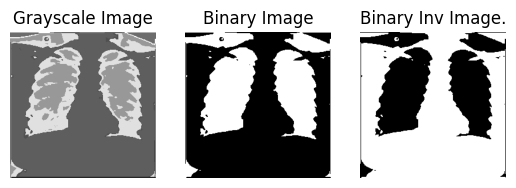

mask_editi_IMG_9538_134496.png


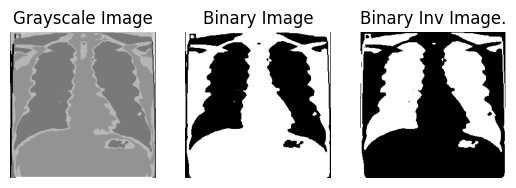

mask_editi_20220317_154454_FC7D53.png


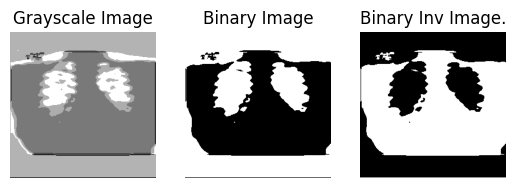

mask_editi_IMG_6573_CA4E75.png


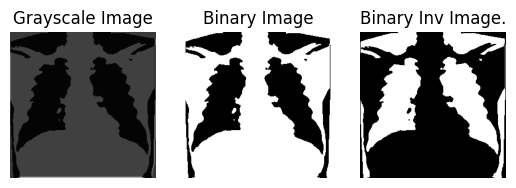

mask_editi_IMG_8047_14C357.png


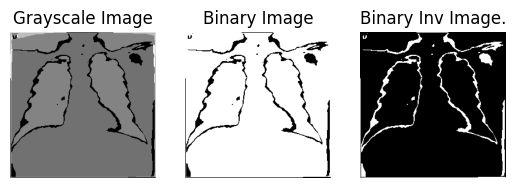

mask_editi_IMG_6918_D97750.png


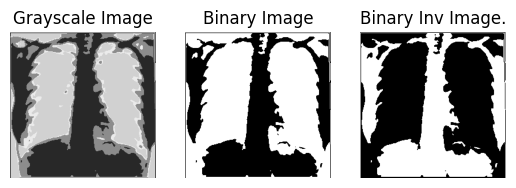

mask_editi_IMG_5501_AE867B.png


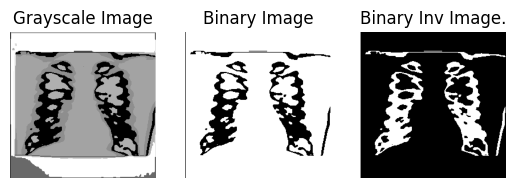

mask_editi_IMG_7985_4BB9C1.png


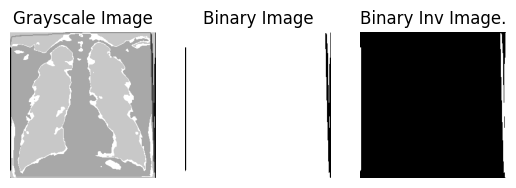

mask_editi_IMG_9181_79372C.png


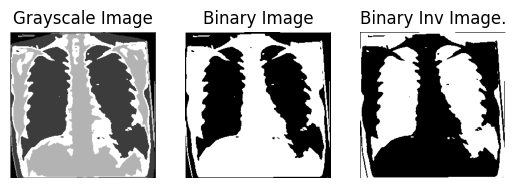

mask_editi_IMG_6979_6AA4FE.png


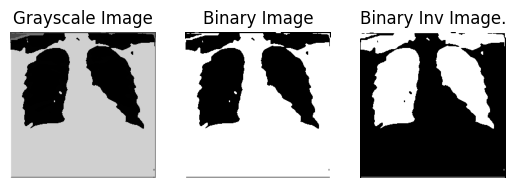

mask_editi_IMG_8338_50D595.png


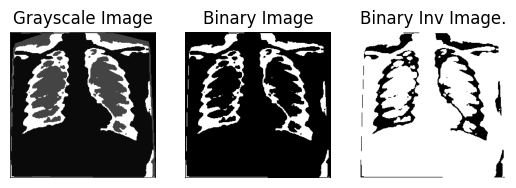

mask_editi_IMG_8840_4CB8D5.png


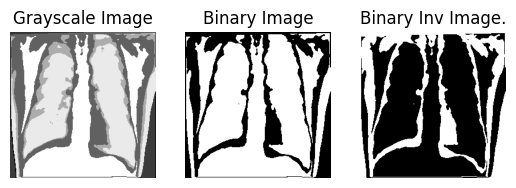

mask_editi_IMG_0099_C9EE29.png


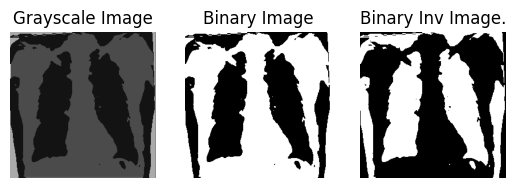

mask_editi_IMG_6745_8F8E26.png


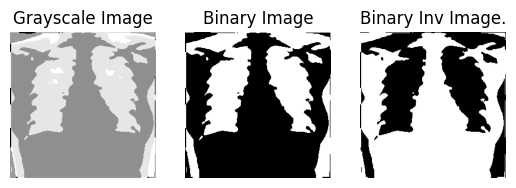

mask_editi_IMG_9689_24016A.png


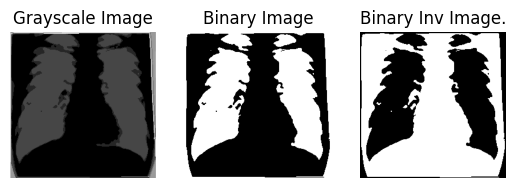

mask_editi_20220321_145002_955000.png


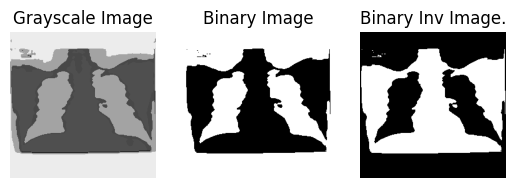

mask_editi_IMG_5604_466E22.png


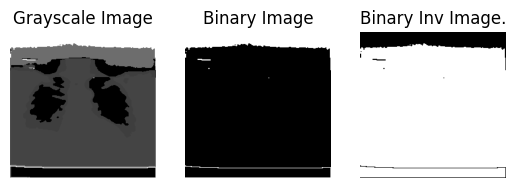

mask_editi_IMG_7558_D63002.png


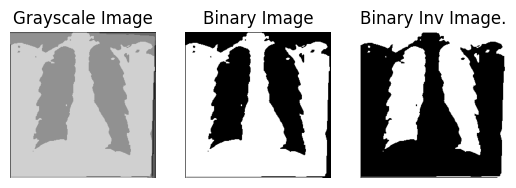

mask_editi_IMG_0588_heic__94D7BF.png


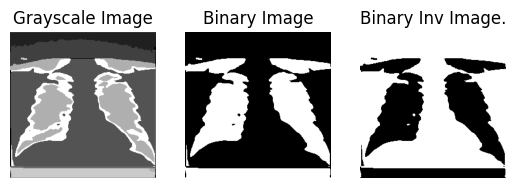

mask_editi_IMG_8389_006B58.png


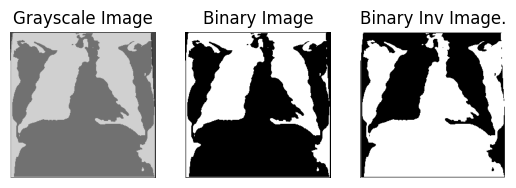

mask_editi_20220317_150814_8B37FA.png


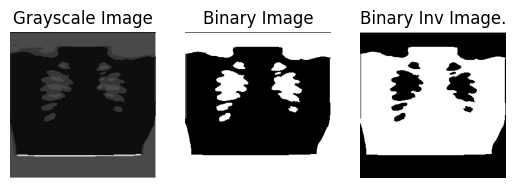

mask_editi_IMG_8508_C3580E.png


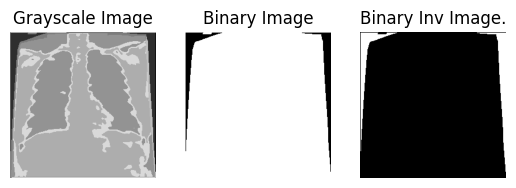

mask_editi_IMG_5505_041379.png


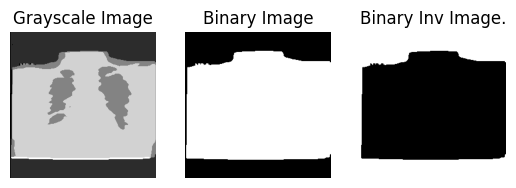

mask_editi_IMG_7408_3E3B70.png


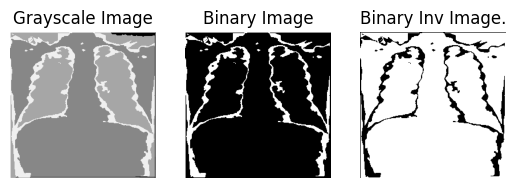

mask_editi_IMG_6106_heic_6BD2BC.png


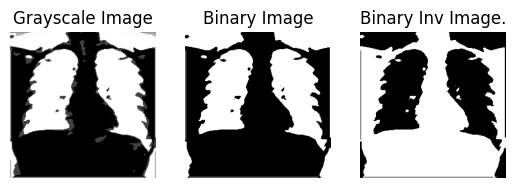

mask_editi_IMG_8176_4331F3.png


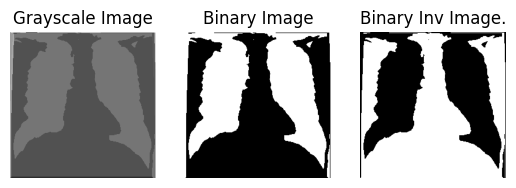

mask_editi_IMG_6955_9F38D8.png


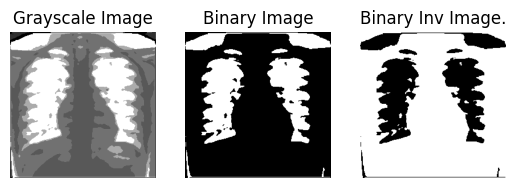

mask_editi_IMG_8818_06F7AE.png


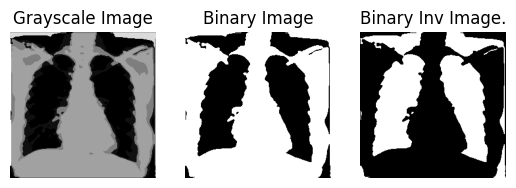

mask_editi_20220315_191628_2AB2E8.png


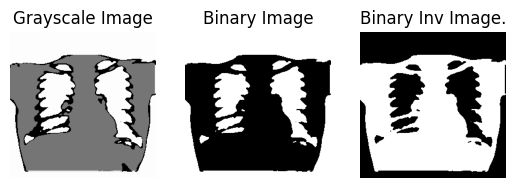

mask_editi_IMG_6957_F0F599.png


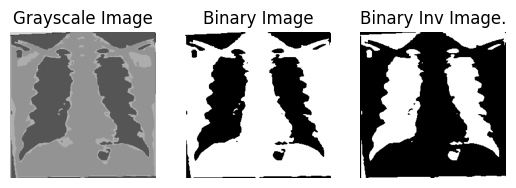

mask_editi_20220321_154614_06D758.png


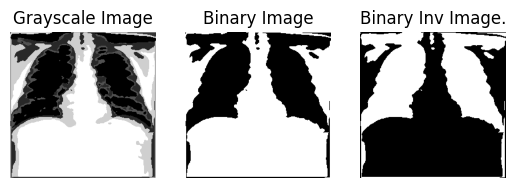

mask_editi_IMG_6897_ADBD3F.png


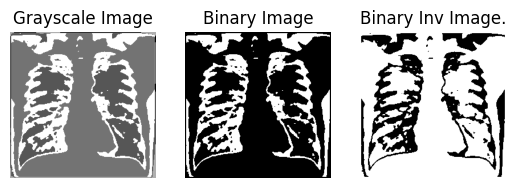

mask_editi_20220317_152915_C0994E.png


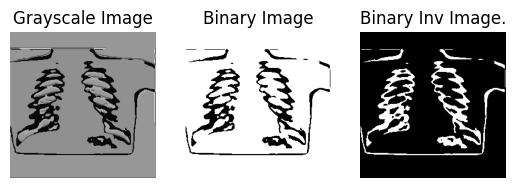

mask_editi_IMG_9491_458D12.png


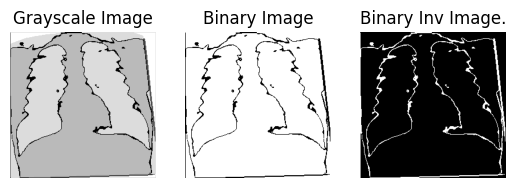

mask_editi_20220317_145718_710512.png


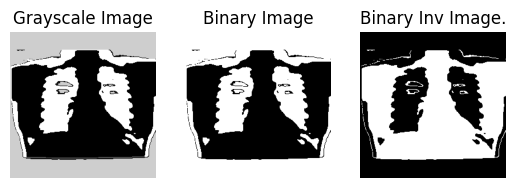

mask_editi_IMG_9620_16B93E.png


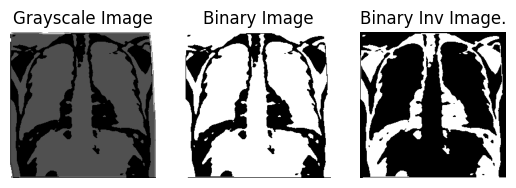

mask_editi_IMG_7134_heic_6FF141.png


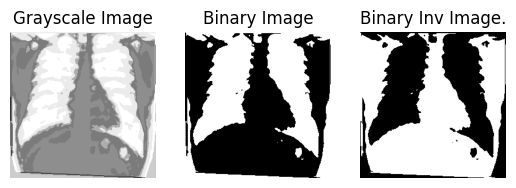

mask_editi_20220321_145409_4FA6FB.png


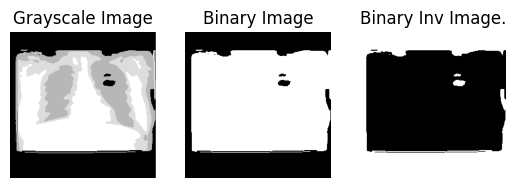

mask_editi_20220317_181312_F99B8B.png


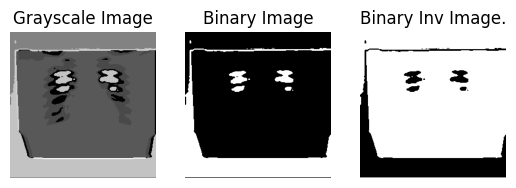

mask_editi_IMG_5507_B24045.png


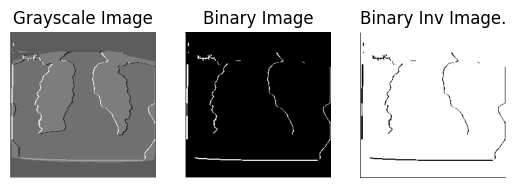

mask_editi_20220317_145159_A19876.png


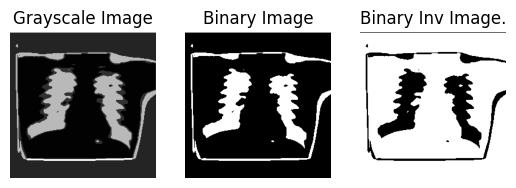

mask_editi_IMG_8003_heic_135DBB.png


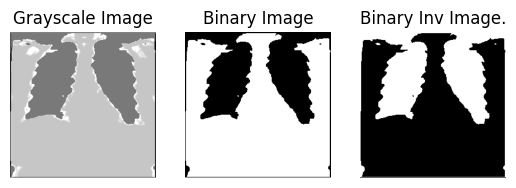

mask_editi_20220315_191002_5649EF.png


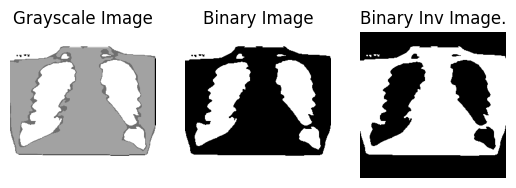

mask_editi_IMG_7179_heic_55B1B6.png


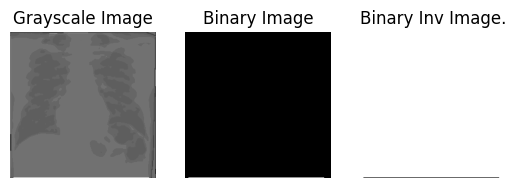

mask_editi_20220317_160343_AF999F.png


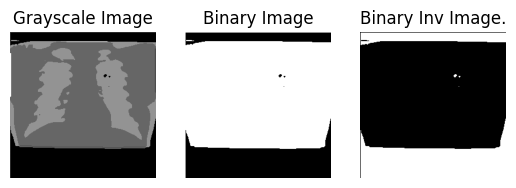

mask_editi_IMG_7756_716641.png


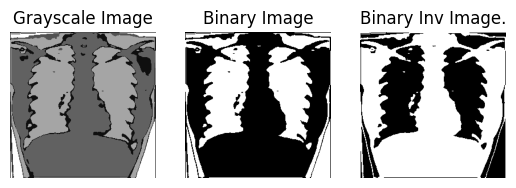

mask_editi_IMG_6492_E2D892.png


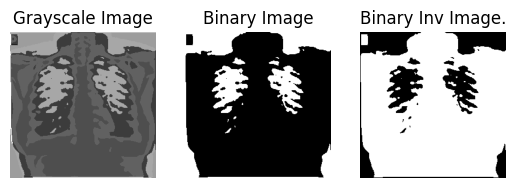

mask_editi_IMG_6099_heic_E414AC.png


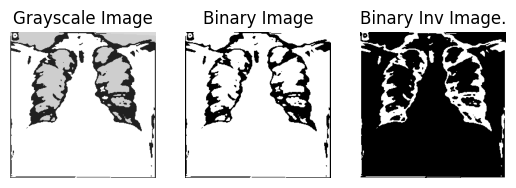

mask_editi_IMG_6742_002717.png


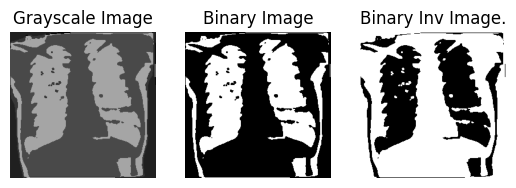

mask_editi_IMG_8058_18C158.png


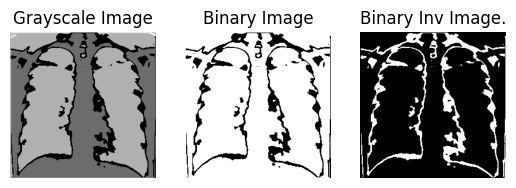

mask_editi_IMG_6349_76DA46.png


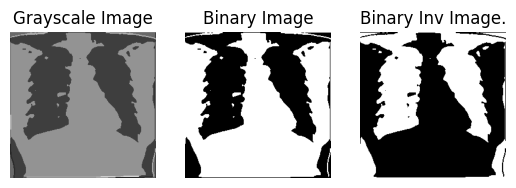

mask_editi_20220317_171516_C1E622.png


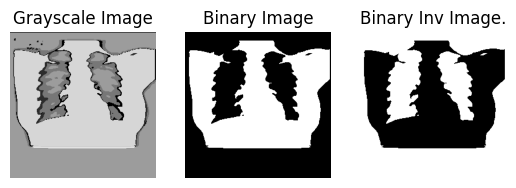

mask_editi_IMG_7714_CADCD5.png


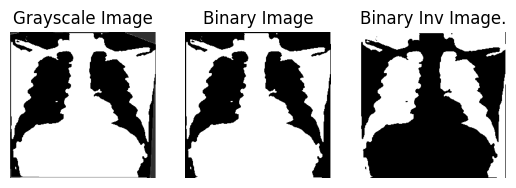

mask_editi_IMG_8419_21B8BB.png


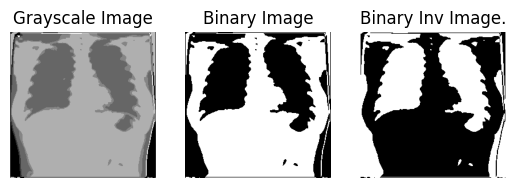

mask_editi_20220315_191353_0F33D8.png


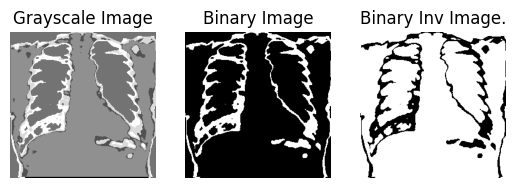

mask_editi_IMG_6622_4892C2.png


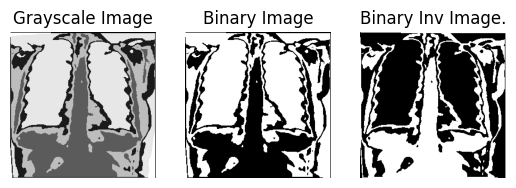

mask_editi_IMG_0081_FEDB88.png


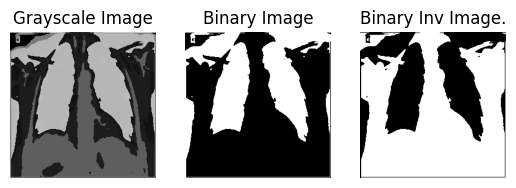

mask_editi_20220317_181626_39B75E.png


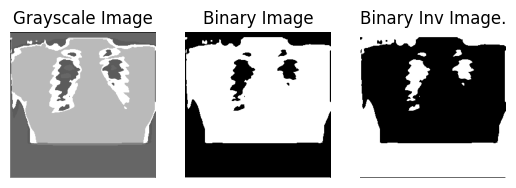

mask_editi_IMG_6949_10A70C.png


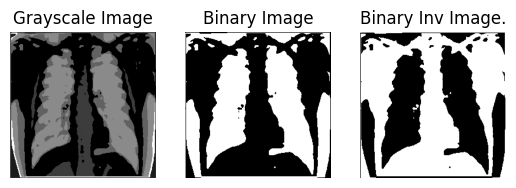

mask_editi_IMG_7651_0554FA.png


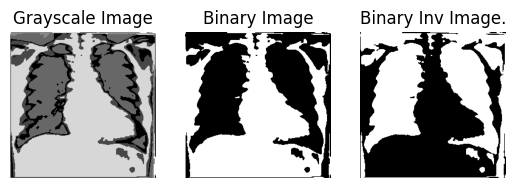

mask_editi_IMG_8347_2B0DB4.png


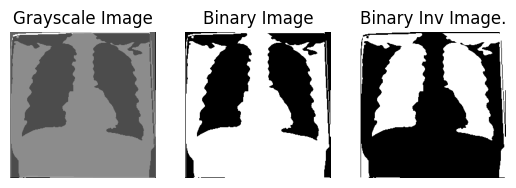

mask_editi_IMG_7004_1D23C3.png


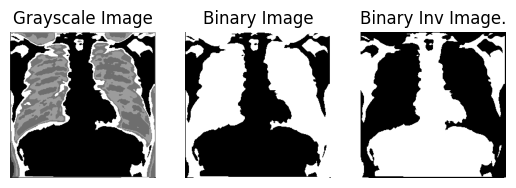

mask_editi_IMG_7812_FAB668.png


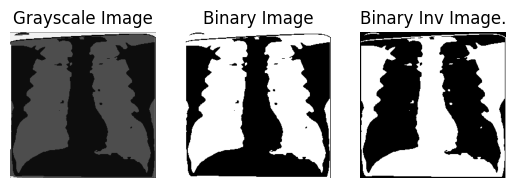

mask_editi_IMG_0238_8E5495.png


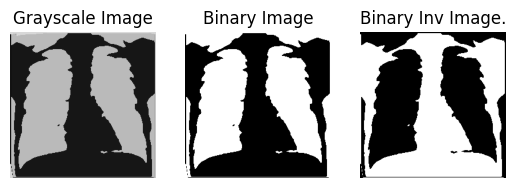

mask_editi_IMG_6787_1B178C.png


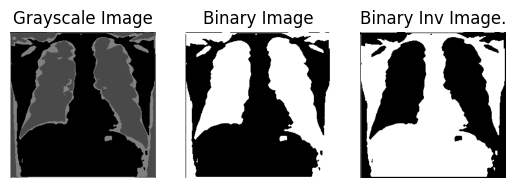

mask_editi_20220317_170846_49DA15.png


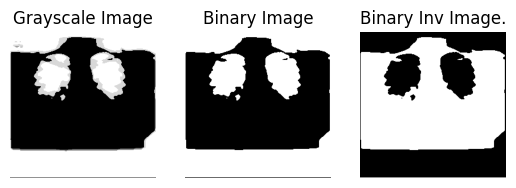

mask_editi_IMG_7695_EA901D.png


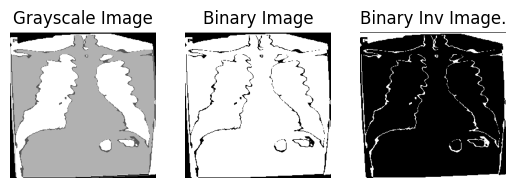

mask_editi_IMG_8141_9EC1C6.png


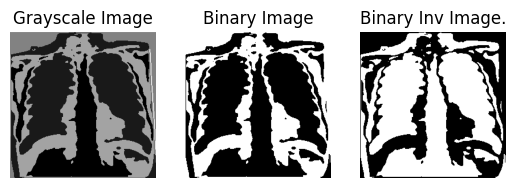

mask_editi_20220317_165040_DE2DEF.png


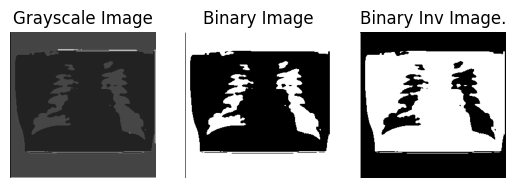

mask_editi_20220317_150844_6DE99D.png


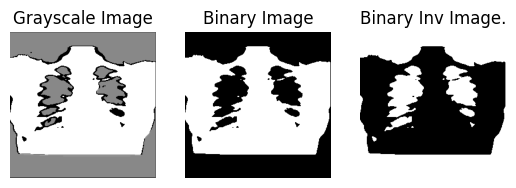

mask_editi_20220317_161215_7B2471.png


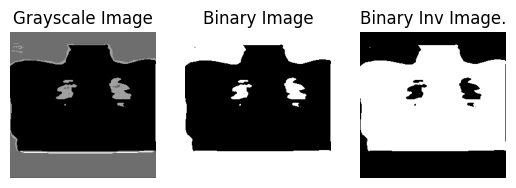

mask_editi_20220321_154404_1C3228.png


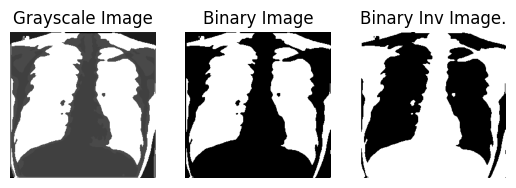

mask_editi_20220317_164901_A5EA25.png


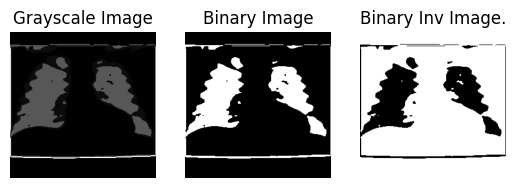

mask_editi_IMG_6120_heic_2F1D3A.png


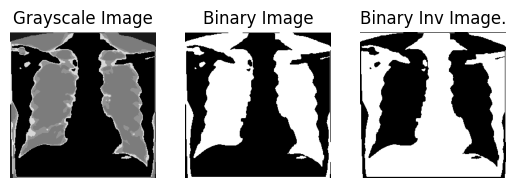

mask_editi_IMG_7520_90887D.png


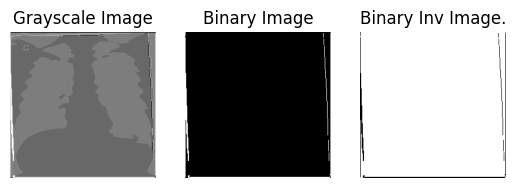

mask_editi_IMG_9578_1EE30E.png


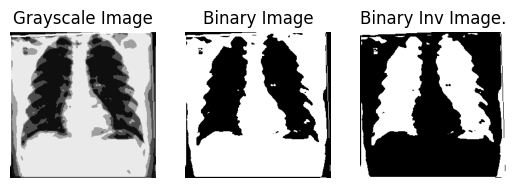

mask_editi_20220315_185346_E68377.png


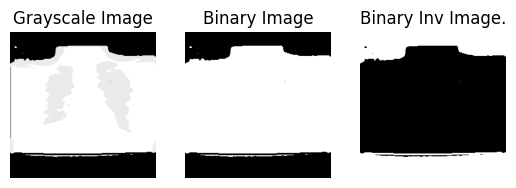

mask_editi_IMG_8537_E4111F.png


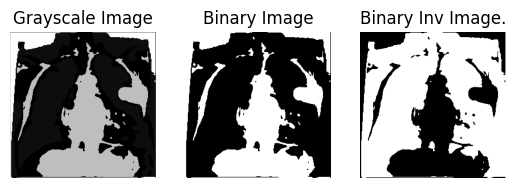

mask_editi_IMG_6845_E1A4CF.png


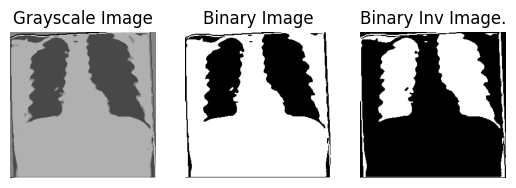

mask_editi_IMG_7136_heic_2E9961.png


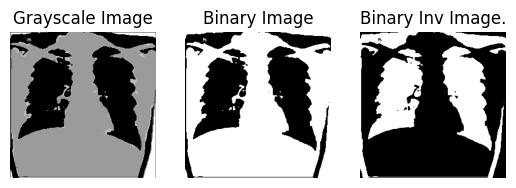

mask_editi_IMG_8949_475A21.png


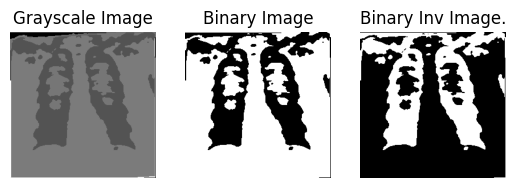

mask_editi_IMG_6253_93D38D.png


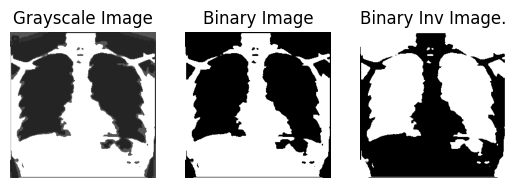

mask_editi_IMG_6825_A5F50F.png


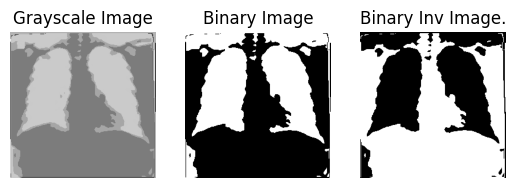

mask_editi_IMG_7183_heic_6A0C76.png


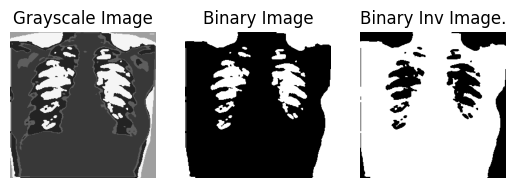

mask_editi_IMG_6861_33B6BA.png


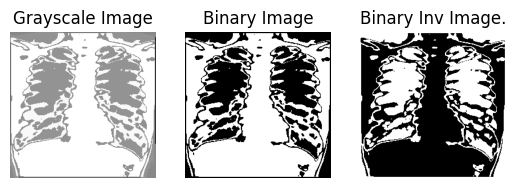

mask_editi_IMG_6422_AA6F4F.png


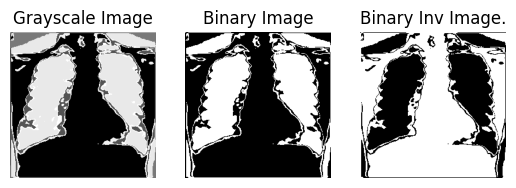

mask_editi_IMG_6458_A40F67.png


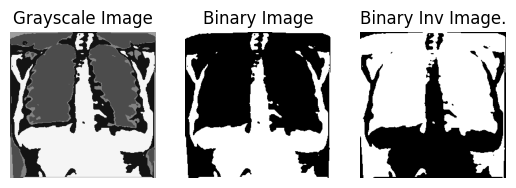

mask_editi_IMG_7580_D97F40.png


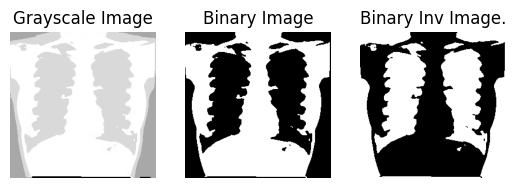

mask_editi_IMG_8462_D7269F.png


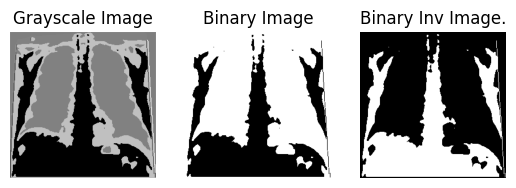

mask_editi_IMG_5303_8D67A2.png


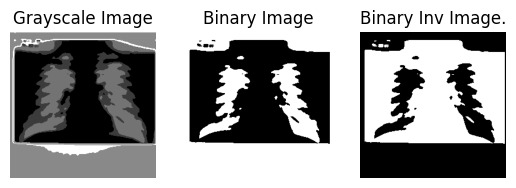

mask_editi_IMG_6104_heic_B4F0F5.png


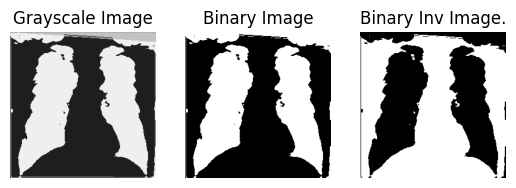

mask_editi_20220321_145336_9E3834.png


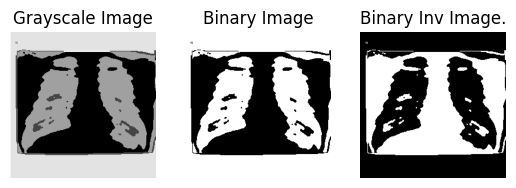

mask_editi_IMG_6935_4C8089.png


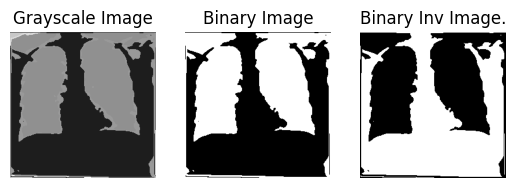

mask_editi_IMG_7602_3080B2.png


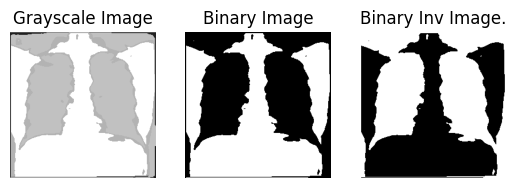

mask_editi_IMG_8978_274D4B.png


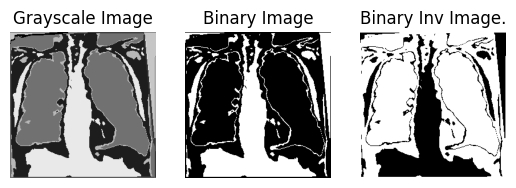

mask_editi_IMG_6882_EF506A.png


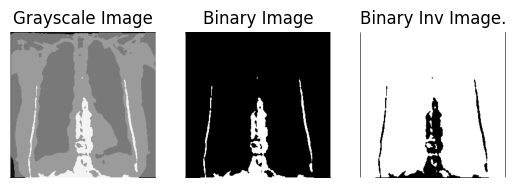

mask_editi_IMG_8899_091F2A.png


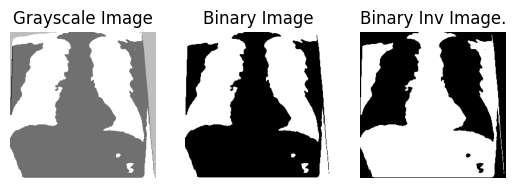

mask_editi_IMG_7422_E633FB.png


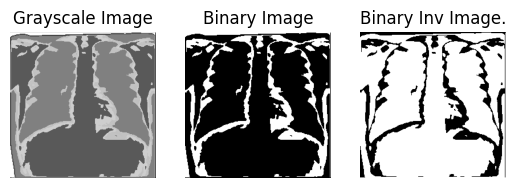

mask_editi_IMG_9138_8180B4.png


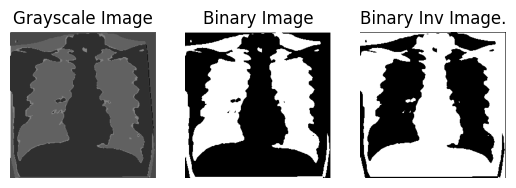

mask_editi_IMG_9190_DBD942.png


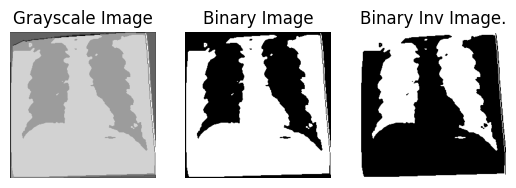

mask_editi_IMG_9259_614C85.png


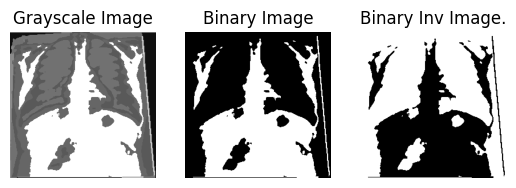

mask_editi_IMG_6109_heic_6DC2AE.png


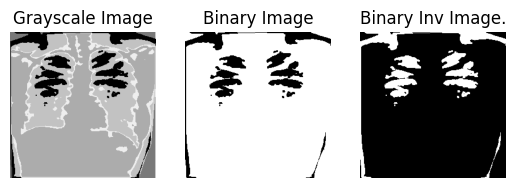

mask_editi_20220317_152524_FA09EF.png


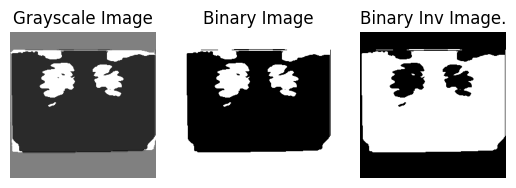

mask_editi_IMG_9219_D054C4.png


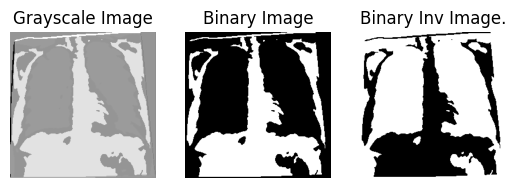

In [9]:
path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/'
imgs = os.listdir(path)
l_thresh = []
l_thresh_ = []
for im_nm in imgs:
    im_path = '/home/otto.tavares/public/segmentation_wnet/results_masks/SantaCasa_anonimizado_valid_completo/%s' % (im_nm)
    # load the input image
    img = cv2.imread(im_path)

    # convert the input image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # apply thresholding to convert grayscale to binary image - adaptative by otsu
    ret,thresh = cv2.threshold(gray,122,255,cv2.THRESH_BINARY + 
                                            cv2.THRESH_OTSU)
    # apply thresholding to convert grayscale to binary image - adaptative by otsu
    ret_inv,thresh_inv = cv2.threshold(gray,122,255,cv2.THRESH_BINARY_INV + 
                                            cv2.THRESH_OTSU)
    
    l_thresh.append(thresh)
    l_thresh_.append(thresh_inv)

    # convert BGR to RGB to display using matplotlib
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # display Original, Grayscale and Binary Images
    #plt.subplot(131),plt.imshow(imgRGB,cmap = 'gray'),plt.title('Original Image'), plt.axis('off')
    print(im_nm)
    plt.subplot(131),plt.imshow(gray,cmap = 'gray'),plt.title('Grayscale Image'),plt.axis('off')
    plt.subplot(132),plt.imshow(thresh,cmap = 'gray'),plt.title('Binary Image'),plt.axis('off')
    plt.subplot(133),plt.imshow(thresh_inv,cmap = 'gray'),plt.title('Binary Inv Image.'),plt.axis('off')
    plt.show()

In [10]:
len(l_thresh)

167

In [70]:
#getting a center retangle of the image, so as to binaryze by lung information
height, width = gray.shape
upper_left = (width // 4, height // 4)
bottom_right = (width * 3 // 4, height * 3 // 4)
rect_img = gray[upper_left[1]: bottom_right[1] + 1, upper_left[0]: bottom_right[0] + 1]



array([  0, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0,
         0,   0,   0,   0,   0, 255, 255,   0,   0,   0,   0,   0,   0,
         0, 255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0,   0,
         0,   0,   0,   0,   0, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255,   0,   0,   0, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
       255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 25

In [4]:
(1 - 11/167)

0.9341317365269461

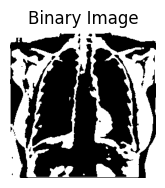

In [44]:
plt.subplot(133),plt.imshow(l_thresh[1],cmap = 'gray'),plt.title('Binary Image'),plt.axis('off')
plt.show()